In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# import matplotlib to show plots inline.
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import glob
import os

import astropy.units as u
import matplotlib as mpl
import sys 
sys.path.append("..")
from plot_OpSims import plot_OpSims_hist

In [3]:
# import maf python modules
import lsst.sims.maf.db as db
import lsst.sims.maf.metrics as metrics
import lsst.sims.maf.slicers as slicers
import lsst.sims.maf.stackers as stackers
import lsst.sims.maf.plots as plots
import lsst.sims.maf.metricBundles as metricBundles

In [4]:
# import convenience functions
import sys 
sys.path.append("../../LSST_OpSim")
from Scripts_NBs.opsimUtils import *

## Load the results
We first load the results of the run into memory. We will read jointly the FBS v1.5 and FBS v1.6 results, and will differentiate at the time of plotting.

In [5]:
NSIDE=64
your_username = "rjassef"
folder_mafoutput = "Color_EM5_{0:d}".format(NSIDE)
resultDbPath = '/home/idies/workspace/Storage/{0}/persistent/MAFOutput/{1}'.format(
    your_username, folder_mafoutput)
metricDataPath = '/home/idies/workspace/Storage/{0}/persistent/MAFOutput/{1}/MetricData/'.format(
    your_username, folder_mafoutput)

In [6]:
# get a dictionary of resultDb from given directory
resultDbs = getResultsDbs(resultDbPath)

In [7]:
#Read the list of current OpSims to be used for the analysis. 
Current_OpSims = np.genfromtxt("../Run_Info/Current_list_of_OpSims.txt", dtype='U')

In [8]:
#Find if any current OpSims are missing from the runs. 
print(np.setdiff1d(Current_OpSims, list(resultDbs.keys())))

[]


In [9]:
# retrieve metricBundles for each opsim run and store them in a dictionary
bundleDicts_raw = dict()
for runName in resultDbs:
    if runName in Current_OpSims:
        bundleDicts_raw[runName] = bundleDictFromDisk(resultDbs[runName], runName, metricDataPath)

Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSIDE=64, approximate resolution 54.967783 arcminutes
Healpix slicer using NSID

In [10]:
#Rearrange the bundleDicts_raw dictionary so that the keys are always the same as for the first run.
dbRuns = list(bundleDicts_raw.keys())
Keys = list(bundleDicts_raw[dbRuns[0]].keys())
bundleDicts = dict()
for runName in dbRuns:
    bundleDicts[runName] = dict()
    Keys_raw = bundleDicts_raw[runName]
    for Key in Keys:
        for Key_raw in Keys_raw:
            if Key[1]==Key_raw[1]:
                bundleDicts[runName][Key] = bundleDicts_raw[runName][Key_raw]

In [11]:
# check keys
bd_keys = list(bundleDicts[dbRuns[0]].keys())
print(bd_keys, len(list(bundleDicts.keys())), len(list(bundleDicts_raw.keys())))
print(Keys)

[(1, 'Exgalm5_color_with_cuts_AGN_ug_mean'), (2, 'Exgalm5_color_with_cuts_AGN_gr_mean'), (3, 'Exgalm5_color_with_cuts_AGN_ri_mean'), (4, 'Exgalm5_color_with_cuts_AGN_iz_mean'), (5, 'Exgalm5_color_with_cuts_AGN_zy_mean')] 160 160
[(1, 'Exgalm5_color_with_cuts_AGN_ug_mean'), (2, 'Exgalm5_color_with_cuts_AGN_gr_mean'), (3, 'Exgalm5_color_with_cuts_AGN_ri_mean'), (4, 'Exgalm5_color_with_cuts_AGN_iz_mean'), (5, 'Exgalm5_color_with_cuts_AGN_zy_mean')]


In [12]:
#Make sure that the plots folder exists. 
plots_folder = "plots_current_opsims_{0:d}".format(NSIDE)
if not os.path.exists(plots_folder):
    os.mkdir(plots_folder)

## Assef et el. (2010) AGN template colors

In [13]:
z=2.0
from quasar_colors.quasar_colors import Assef10_colors

(1, 'Exgalm5_color_with_cuts_AGN_ug_mean')
filterdist_indx3_v1.5_10yrs -1.5813894300052809
u_long_ms_60_v1.7_10yrs -0.6331000828326232
(2, 'Exgalm5_color_with_cuts_AGN_gr_mean')
short_exp_5ns_1expt_v1.5_10yrs -0.11069655937803177
filterdist_indx1_v1.5_10yrs 0.541351699974757
(3, 'Exgalm5_color_with_cuts_AGN_ri_mean')
filterdist_indx6_v1.5_10yrs 0.23914043924046063
ss_heavy_v1.6_10yrs 0.5131144304611055
(4, 'Exgalm5_color_with_cuts_AGN_iz_mean')
filterdist_indx5_v1.5_10yrs 0.3262601749253998
filterdist_indx6_v1.5_10yrs 0.7252375910633634
(5, 'Exgalm5_color_with_cuts_AGN_zy_mean')
barebones_v1.6_10yrs 0.8615292137572714
var_expt_v1.5_10yrs 1.0017989422253182


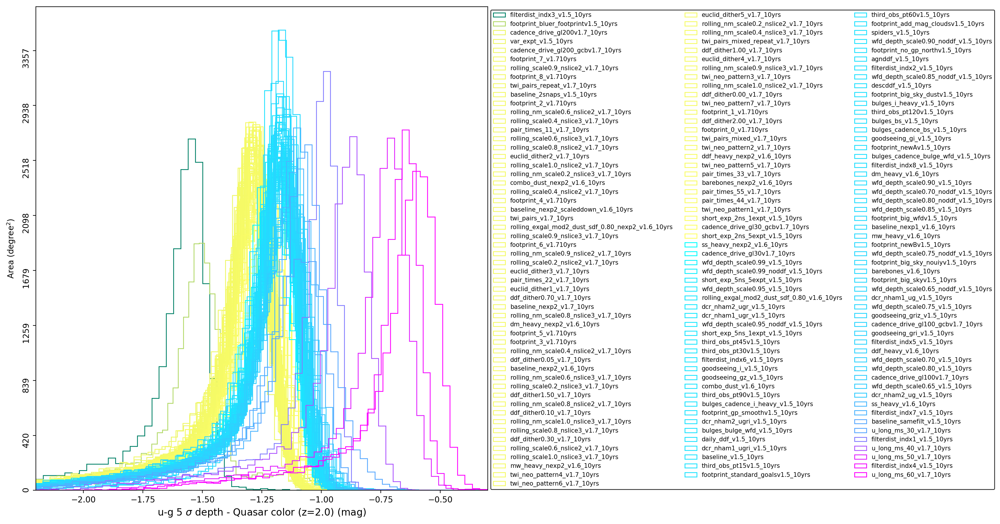

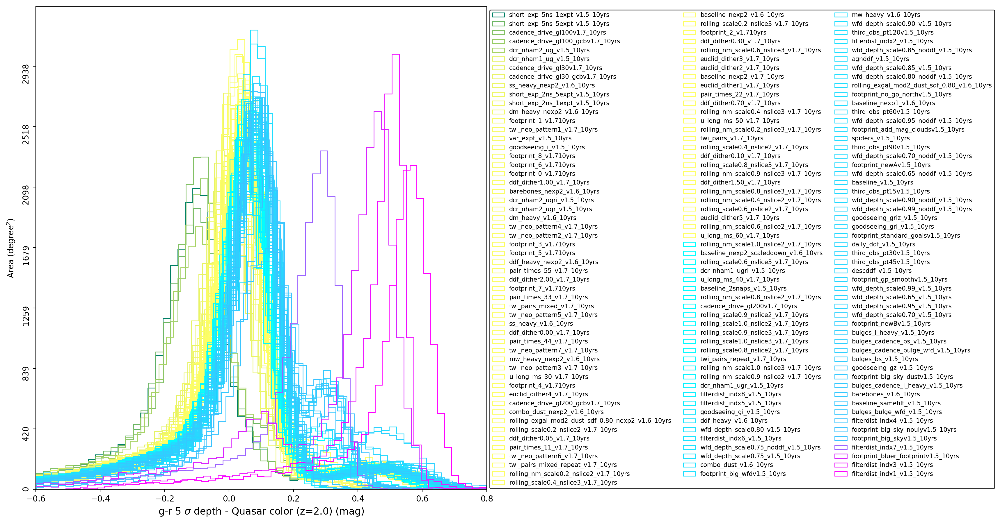

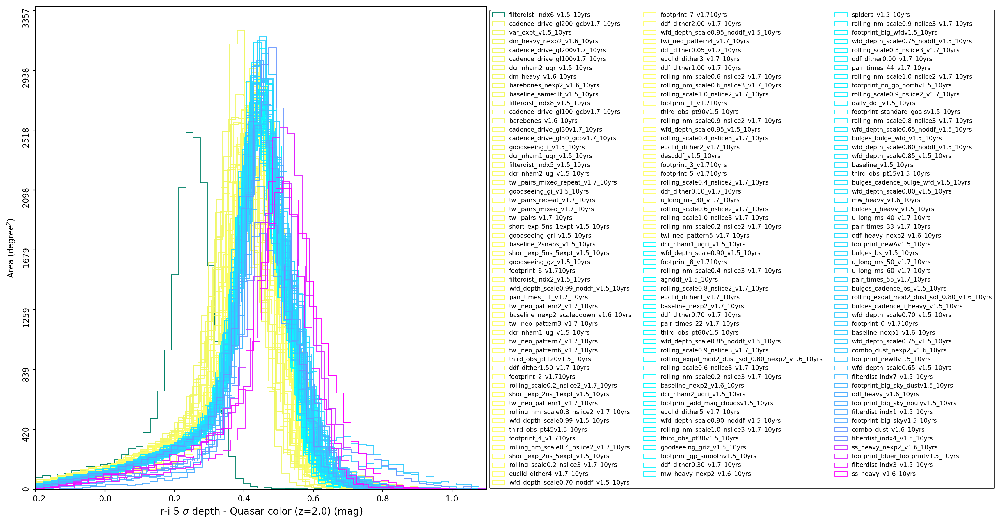

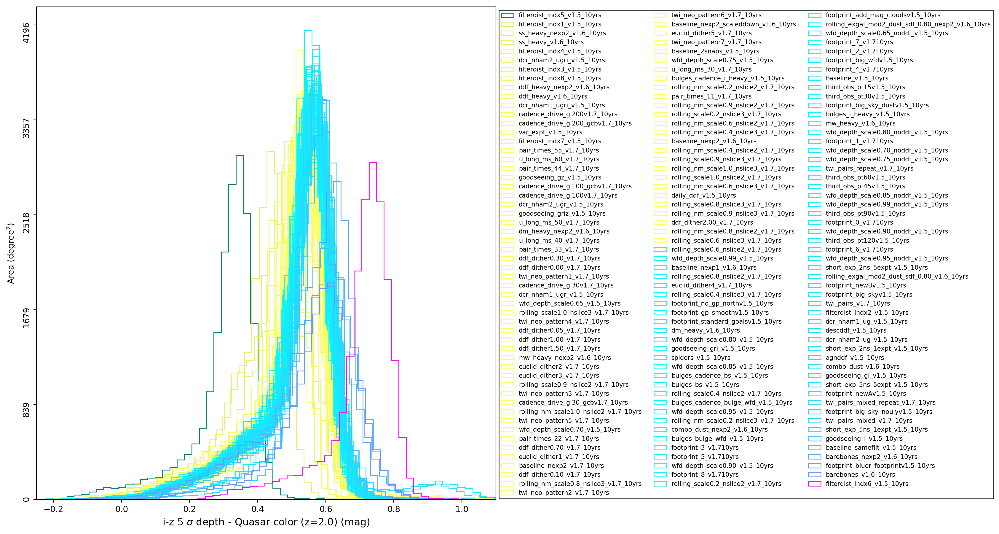

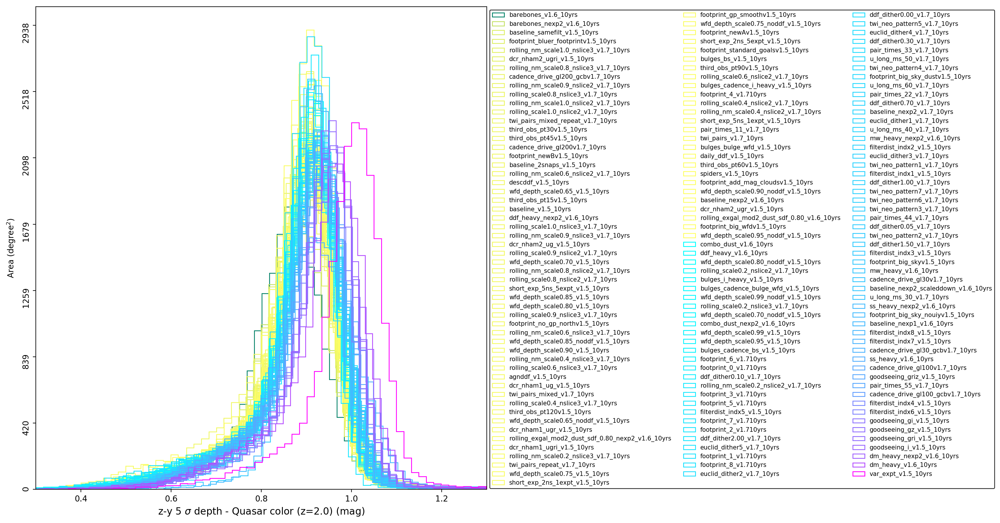

In [14]:
#Area of each element
healpix_pixarea = bundleDicts[dbRuns[0]][Key].slicer.pixArea * u.sr

#X-axis ranges.
xmin = {'u-g':-2.2, 'g-r':-0.60, 'r-i':-0.20, 'i-z':-0.25, 'z-y': 0.30}
xmax = {'u-g':-0.3, 'g-r': 0.80, 'r-i': 1.10, 'i-z': 1.10, 'z-y': 1.30}

filters = ['u','g','r','i','z','y']
for k,filter in enumerate(filters[:-1]):
    Key = Keys[k]
    print(Key)
    color_name = '{0}-{1}'.format(filters[k],filters[k+1])
    
    #Function to process the matric data through.
    quasar_color = Assef10_colors(color_name,z)
    color_excess = lambda color : color-quasar_color

    #X-axis Label
    xlabel = r"{0} 5 $\sigma$ depth - Quasar color (z={1:.1f}) (mag)".format(color_name,z)
    
    #Plot all FBSs together.
    plot_OpSims_hist(Key, bundleDicts, data_func=color_excess, figsize=(10,11), healpix_pixarea=healpix_pixarea, 
                     datamin=xmin[color_name], datamax=xmax[color_name], color_map=[mpl.cm.summer,mpl.cm.cool], 
                     xlabel=xlabel)
    plot_fname = "{0}/Color_z{1}_{2}_Assef10.png".format(plots_folder,z,color_name)
    plt.savefig(plot_fname, dpi=200, bbox_inches='tight')   

## Matthew Temple's AGN Color models

In [15]:
from quasar_colors.quasar_colors import Temple_colors

#### i=21.5

(1, 'Exgalm5_color_with_cuts_AGN_ug_mean')
filterdist_indx3_v1.5_10yrs -1.546289430005281
u_long_ms_60_v1.7_10yrs -0.5980000828326232
(2, 'Exgalm5_color_with_cuts_AGN_gr_mean')
short_exp_5ns_1expt_v1.5_10yrs -0.2678965593780318
filterdist_indx1_v1.5_10yrs 0.38415169997475695
(3, 'Exgalm5_color_with_cuts_AGN_ri_mean')
filterdist_indx6_v1.5_10yrs 0.13804043924046064
ss_heavy_v1.6_10yrs 0.41201443046110553
(4, 'Exgalm5_color_with_cuts_AGN_iz_mean')
filterdist_indx5_v1.5_10yrs 0.2849601749253998
filterdist_indx6_v1.5_10yrs 0.6839375910633634
(5, 'Exgalm5_color_with_cuts_AGN_zy_mean')
barebones_v1.6_10yrs 0.7410292137572714
var_expt_v1.5_10yrs 0.8812989422253181


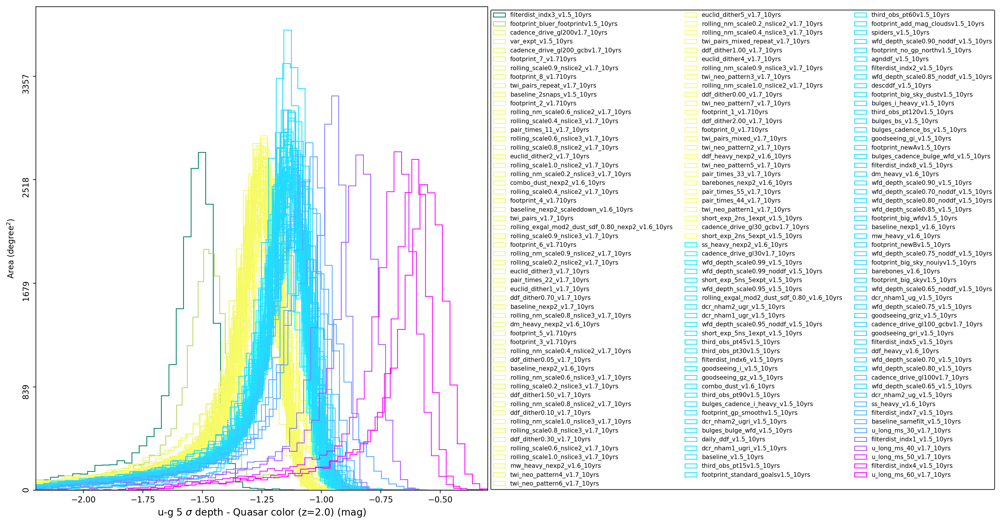

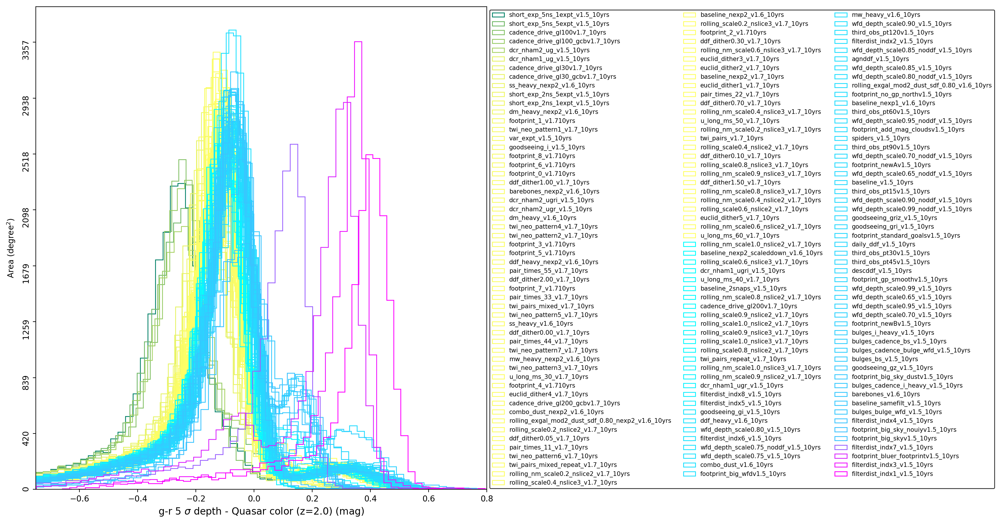

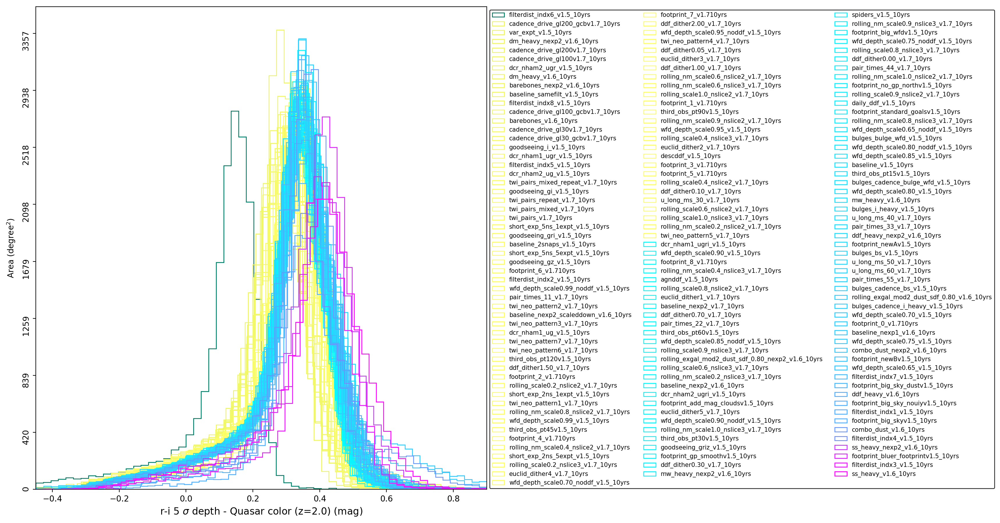

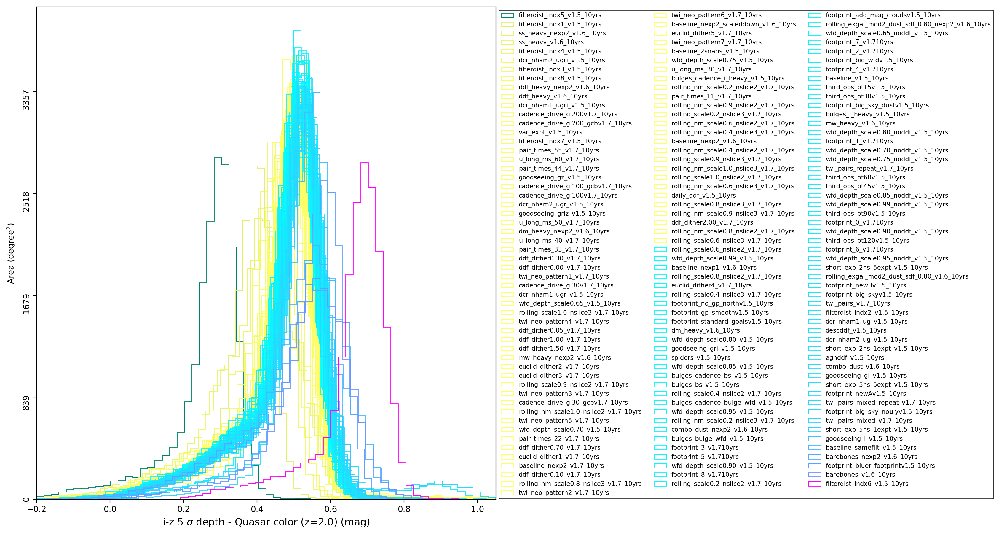

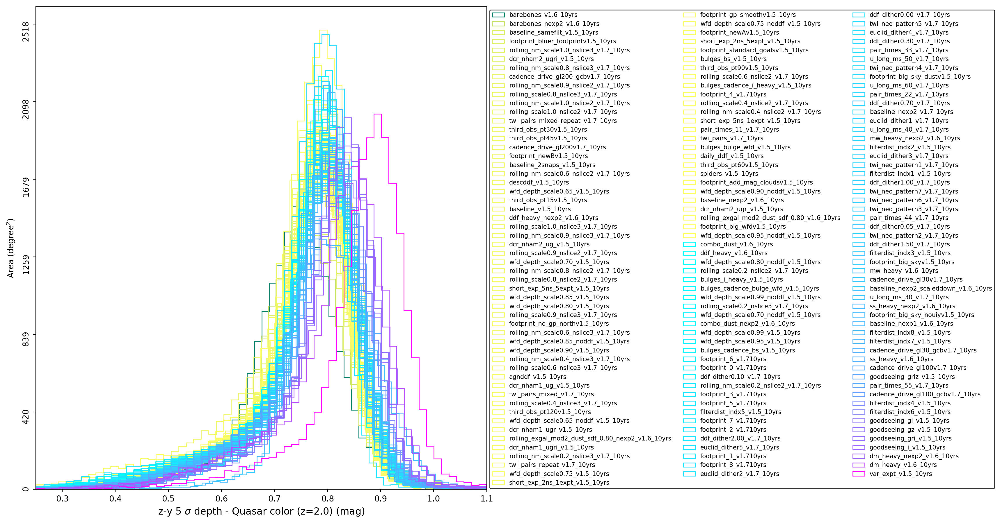

In [16]:
imag = 21.5

#Area of each element
healpix_pixarea = bundleDicts[dbRuns[0]][Key].slicer.pixArea * u.sr

#X-axis ranges.
xmin = {'u-g':-2.2, 'g-r':-0.75, 'r-i':-0.45, 'i-z':-0.20, 'z-y': 0.25}
xmax = {'u-g':-0.3, 'g-r': 0.80, 'r-i': 0.90, 'i-z': 1.05, 'z-y': 1.10}

filters = ['u','g','r','i','z','y']
for k,filter in enumerate(filters[:-1]):
    Key = Keys[k]
    print(Key)
    color_name = '{0}-{1}'.format(filters[k],filters[k+1])
    
    #Function to process the matric data through.
    quasar_color = Temple_colors(color_name,z,imag)
    color_excess = lambda color : color-quasar_color

    #X-axis Label
    xlabel = r"{0} 5 $\sigma$ depth - Quasar color (z={1:.1f}) (mag)".format(color_name,z)
    
    #Plot all FBSs together.
    plot_OpSims_hist(Key, bundleDicts, data_func=color_excess, figsize=(10,11), healpix_pixarea=healpix_pixarea, 
                     datamin=xmin[color_name], datamax=xmax[color_name], color_map=[mpl.cm.summer,mpl.cm.cool], 
                     xlabel=xlabel)
    plot_fname = "{0}/Color_z{1}_{2}_imag{3}_Temple.png".format(plots_folder,z,color_name,imag)
    plt.savefig(plot_fname, dpi=200, bbox_inches='tight')   

#### i=24.5

(1, 'Exgalm5_color_with_cuts_AGN_ug_mean')
filterdist_indx3_v1.5_10yrs -1.5228894300052809
u_long_ms_60_v1.7_10yrs -0.5746000828326232
(2, 'Exgalm5_color_with_cuts_AGN_gr_mean')
short_exp_5ns_1expt_v1.5_10yrs -0.24499655937803178
filterdist_indx1_v1.5_10yrs 0.407051699974757
(3, 'Exgalm5_color_with_cuts_AGN_ri_mean')
filterdist_indx6_v1.5_10yrs 0.11154043924046064
ss_heavy_v1.6_10yrs 0.38551443046110556
(4, 'Exgalm5_color_with_cuts_AGN_iz_mean')
filterdist_indx5_v1.5_10yrs 0.26916017492539984
filterdist_indx6_v1.5_10yrs 0.6681375910633633
(5, 'Exgalm5_color_with_cuts_AGN_zy_mean')
barebones_v1.6_10yrs 0.7256292137572714
var_expt_v1.5_10yrs 0.8658989422253182


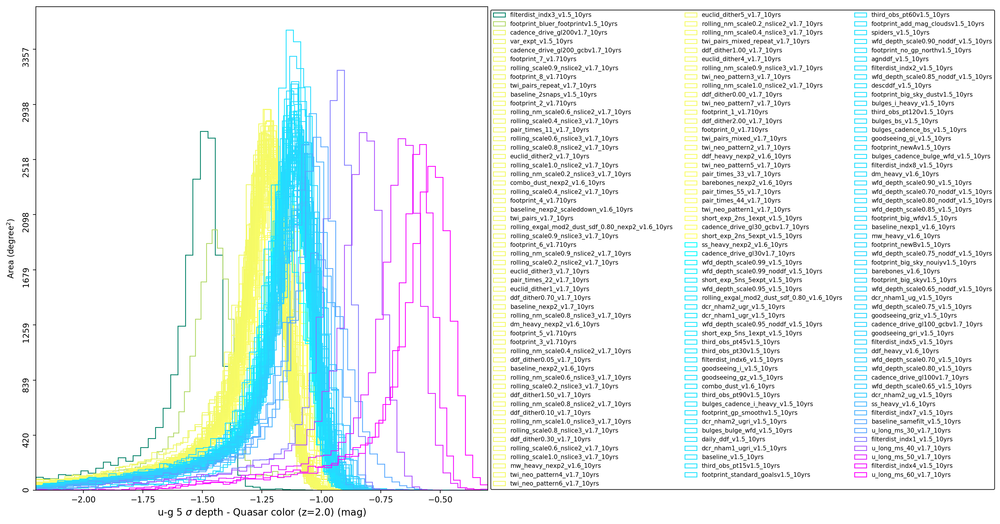

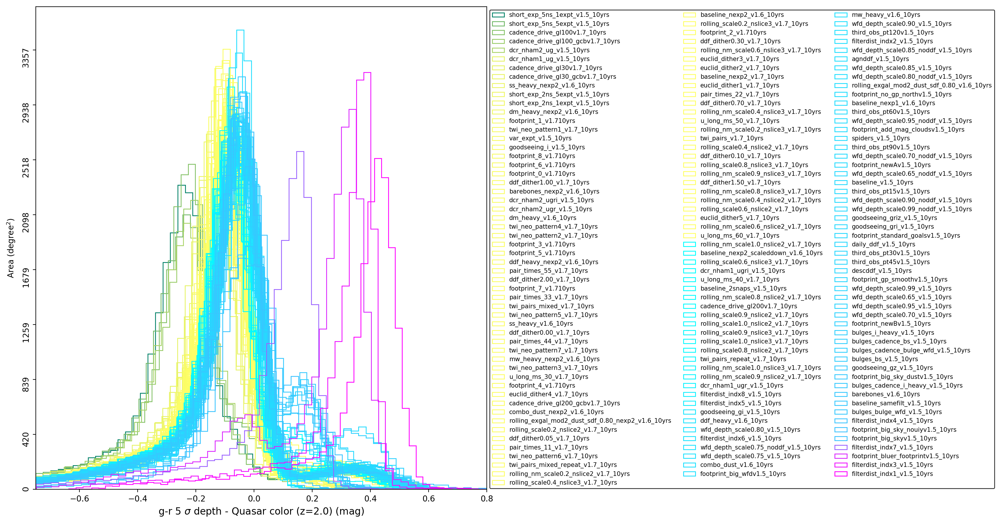

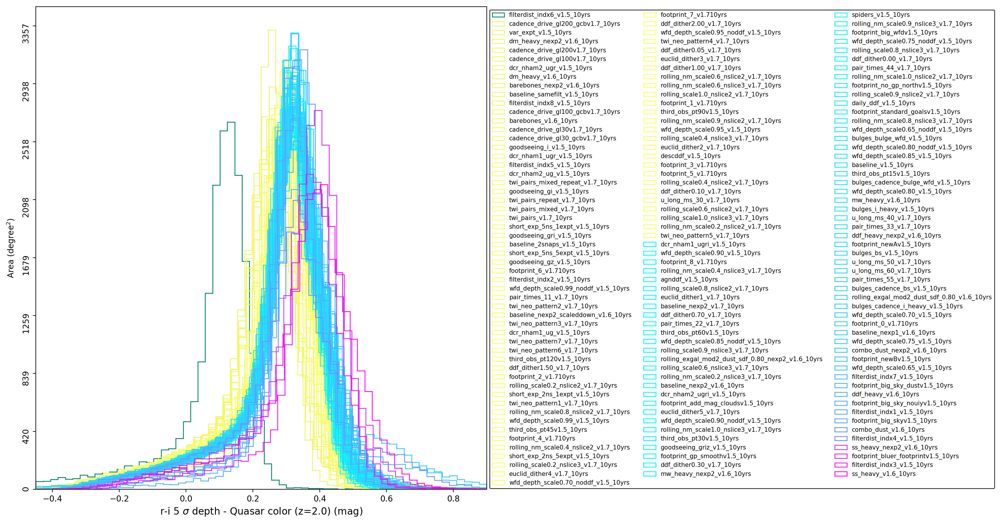

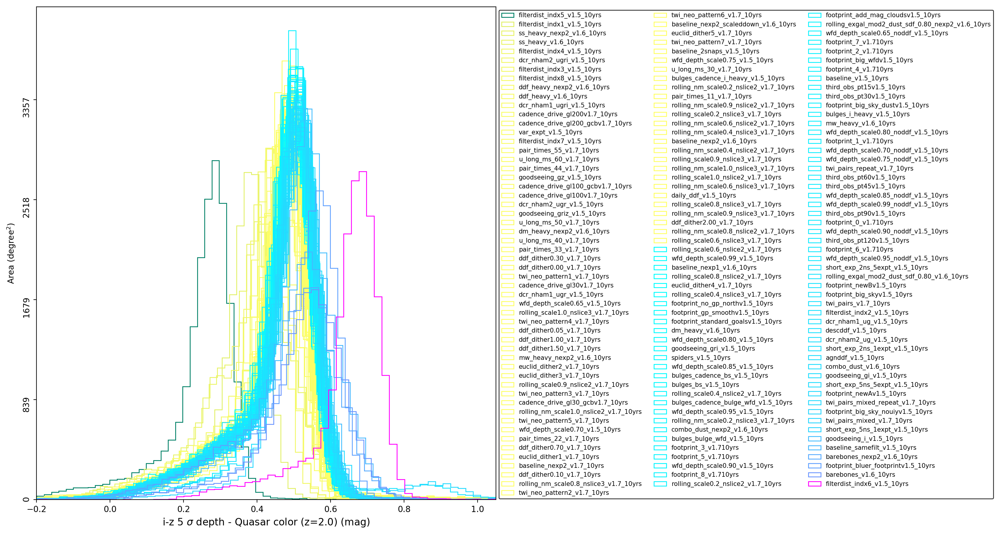

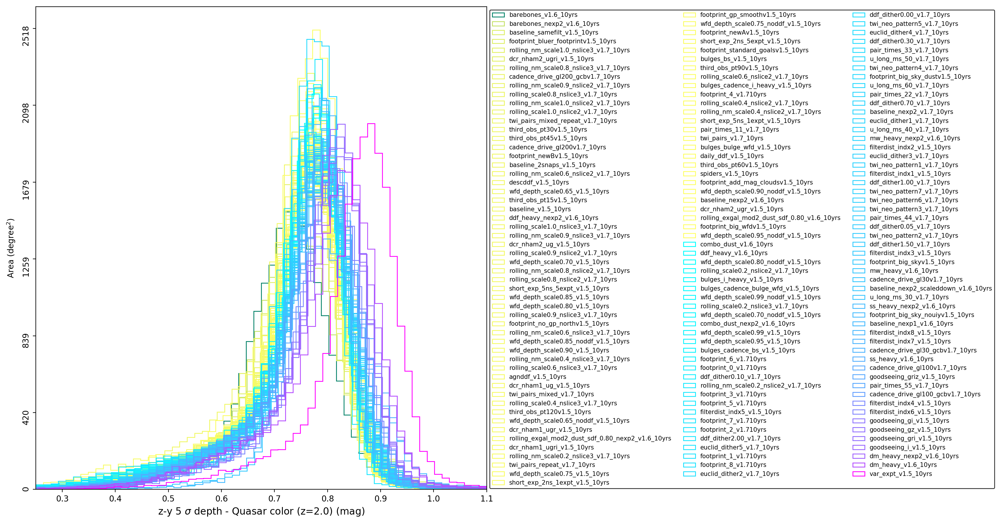

In [17]:
imag = 24.5

#Area of each element
healpix_pixarea = bundleDicts[dbRuns[0]][Key].slicer.pixArea * u.sr

#X-axis ranges.
xmin = {'u-g':-2.2, 'g-r':-0.75, 'r-i':-0.45, 'i-z':-0.20, 'z-y': 0.25}
xmax = {'u-g':-0.3, 'g-r': 0.80, 'r-i': 0.90, 'i-z': 1.05, 'z-y': 1.10}

filters = ['u','g','r','i','z','y']
for k,filter in enumerate(filters[:-1]):
    Key = Keys[k]
    print(Key)
    color_name = '{0}-{1}'.format(filters[k],filters[k+1])
    
    #Function to process the matric data through.
    quasar_color = Temple_colors(color_name,z,imag)
    color_excess = lambda color : color-quasar_color

    #X-axis Label
    xlabel = r"{0} 5 $\sigma$ depth - Quasar color (z={1:.1f}) (mag)".format(color_name,z)
    
    #Plot all FBSs together.
    plot_OpSims_hist(Key, bundleDicts, data_func=color_excess, figsize=(10,11), healpix_pixarea=healpix_pixarea, 
                     datamin=xmin[color_name], datamax=xmax[color_name], color_map=[mpl.cm.summer,mpl.cm.cool], 
                     xlabel=xlabel)
    plot_fname = "{0}/Color_z{1}_{2}_imag{3}_Temple.png".format(plots_folder,z,color_name,imag)
    plt.savefig(plot_fname, dpi=200, bbox_inches='tight')   

#### i=26.0

(1, 'Exgalm5_color_with_cuts_AGN_ug_mean')
filterdist_indx3_v1.5_10yrs -1.5135894300052808
u_long_ms_60_v1.7_10yrs -0.5653000828326232
(2, 'Exgalm5_color_with_cuts_AGN_gr_mean')
short_exp_5ns_1expt_v1.5_10yrs -0.23559655937803178
filterdist_indx1_v1.5_10yrs 0.416451699974757
(3, 'Exgalm5_color_with_cuts_AGN_ri_mean')
filterdist_indx6_v1.5_10yrs 0.10034043924046063
ss_heavy_v1.6_10yrs 0.3743144304611056
(4, 'Exgalm5_color_with_cuts_AGN_iz_mean')
filterdist_indx5_v1.5_10yrs 0.2619601749253998
filterdist_indx6_v1.5_10yrs 0.6609375910633634
(5, 'Exgalm5_color_with_cuts_AGN_zy_mean')
barebones_v1.6_10yrs 0.7173292137572714
var_expt_v1.5_10yrs 0.8575989422253182


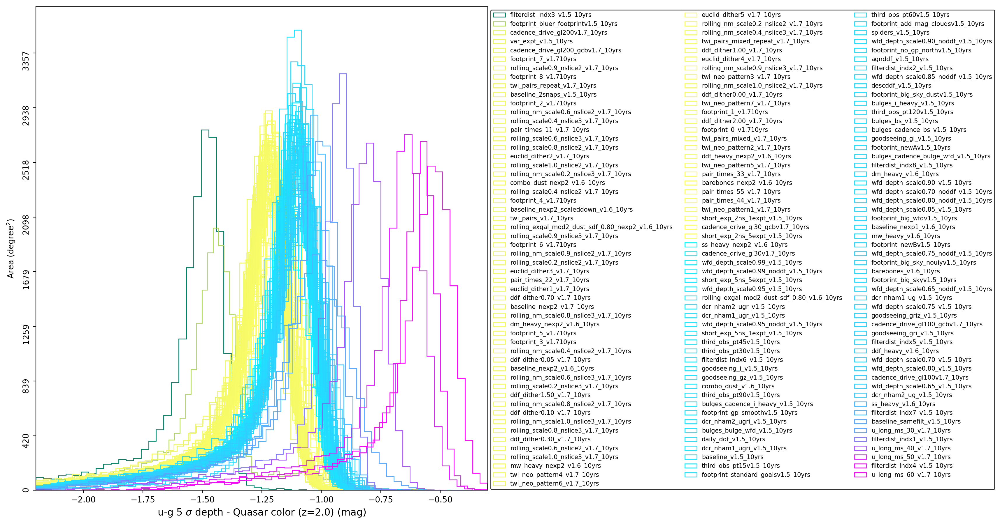

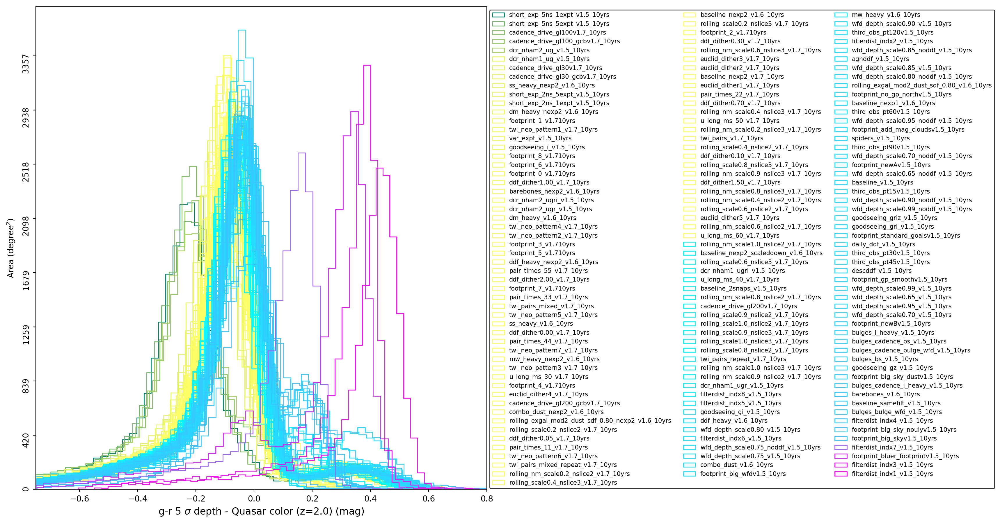

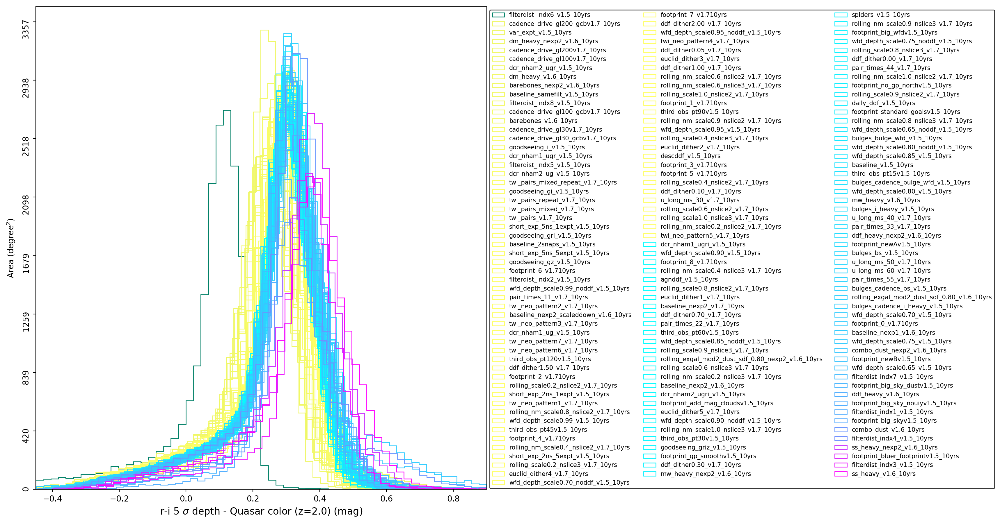

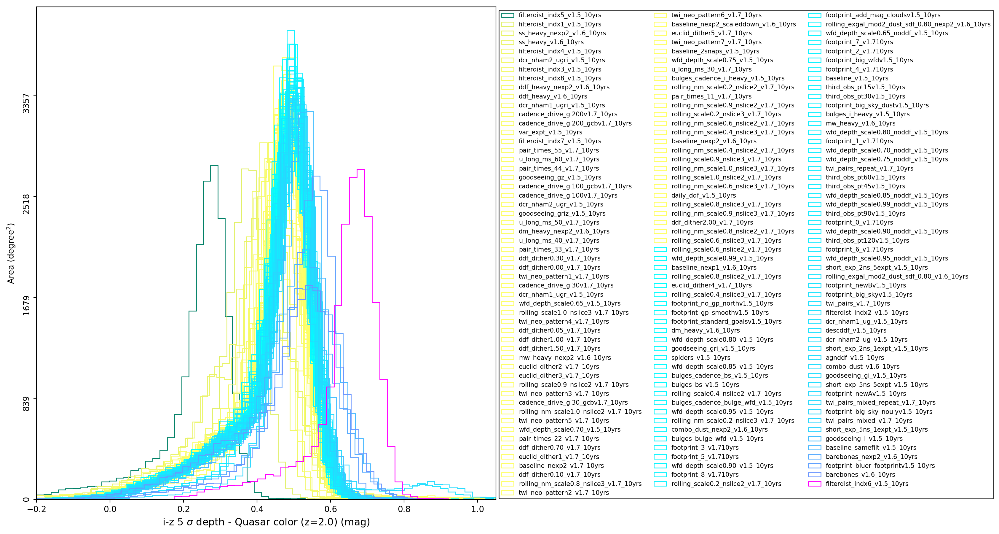

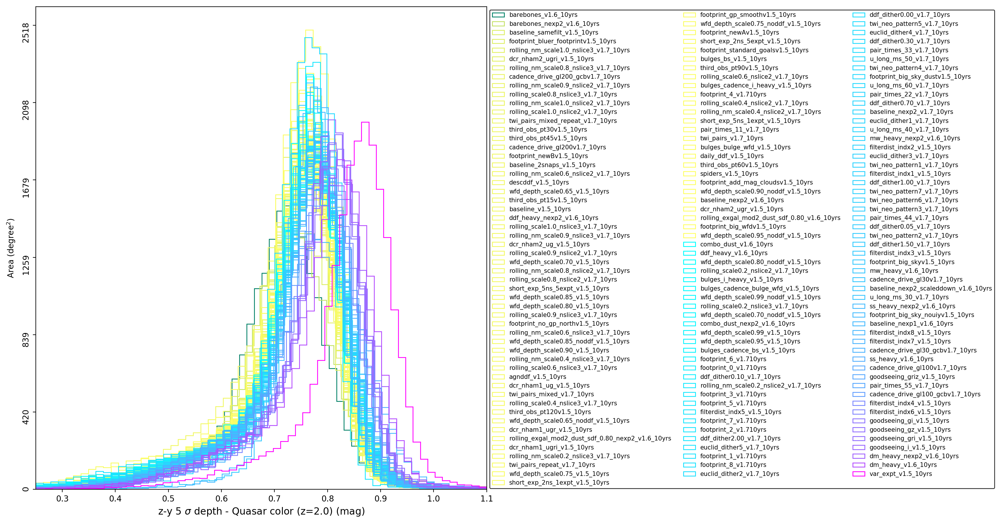

In [18]:
imag = 26.0

#Area of each element
healpix_pixarea = bundleDicts[dbRuns[0]][Key].slicer.pixArea * u.sr

#X-axis ranges.
xmin = {'u-g':-2.2, 'g-r':-0.75, 'r-i':-0.45, 'i-z':-0.20, 'z-y': 0.25}
xmax = {'u-g':-0.3, 'g-r': 0.80, 'r-i': 0.90, 'i-z': 1.05, 'z-y': 1.10}

filters = ['u','g','r','i','z','y']
for k,filter in enumerate(filters[:-1]):
    Key = Keys[k]
    print(Key)
    color_name = '{0}-{1}'.format(filters[k],filters[k+1])
    
    #Function to process the matric data through.
    quasar_color = Temple_colors(color_name,z,imag)
    color_excess = lambda color : color-quasar_color

    #X-axis Label
    xlabel = r"{0} 5 $\sigma$ depth - Quasar color (z={1:.1f}) (mag)".format(color_name,z)
    
    #Plot all FBSs together.
    plot_OpSims_hist(Key, bundleDicts, data_func=color_excess, figsize=(10,11), healpix_pixarea=healpix_pixarea, 
                     datamin=xmin[color_name], datamax=xmax[color_name], color_map=[mpl.cm.summer,mpl.cm.cool], 
                     xlabel=xlabel)
    plot_fname = "{0}/Color_z{1}_{2}_imag{3}_Temple.png".format(plots_folder,z,color_name,imag)
    plt.savefig(plot_fname, dpi=200, bbox_inches='tight')   